# JUAN SIMON SUAREZ ALVARADO #

In [1]:
# Librerias necesarias 

import pandas as pd # Manejo y análisis de estructuras de datos
import numpy as np # Cálculo numérico y el análisis de datos 
import seaborn as sns # Creación de gráficos estadísticos 
import matplotlib.pyplot as plt # Creación de gráficos de dos dimensiones 

# Librerias para implementar ciencias de datos

from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression # Librería para regresión lineal
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import classification_report, confusion_matrix



# Carga de archivos csv del dataset que se utilizará #

In [2]:
data1 = pd.read_csv('cardata.csv')
data2 = pd.read_csv('cardetailsfromdekho.csv')
data3 = pd.read_csv('cardetailsv3.csv')
data4 = pd.read_csv('cardetailsv4.csv')

 **Concatenar los DataFrames en uno solo**

In [3]:
frames = [data1, data2, data3, data4]
data = pd.concat(frames, ignore_index=True)

# Mostrar las primeras filas del DataFrame combinado
data.head()

,Car_Name,Year,Selling_Price,Present_Price,Kms_Driven,Fuel_Type,Seller_Type,Transmission,Owner,name,...,Seller Type,Engine,Max Power,Max Torque,Drivetrain,Length,Width,Height,Seating Capacity,Fuel Tank Capacity
0,ritz,2014.0,3.35,5.59,27000.0,Petrol,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,sx4,2013.0,4.75,9.54,43000.0,Diesel,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,ciaz,2017.0,7.25,9.85,6900.0,Petrol,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,wagon r,2011.0,2.85,4.15,5200.0,Petrol,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,swift,2014.0,4.60,6.87,42450.0,Diesel,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
data.shape

(14828, 39)

In [5]:
# Identificar valores faltantes
missing_values = data.isnull().sum()

# Calcular el porcentaje de valores faltantes
missing_percentage = (data.isnull().sum() / len(data)) * 100

# Crear un DataFrame para mostrar los resultados
missing_data = pd.DataFrame({
    'Missing Values': missing_values,
    'Percentage (%)': missing_percentage
})

In [6]:
print("Valores faltantes por columna:")
print(missing_data[missing_data['Missing Values'] > 0].sort_values(by='Missing Values', ascending=False))


Valores faltantes por columna:
                    Missing Values  Percentage (%)
Car_Name                     14527       97.970057
Selling_Price                14527       97.970057
Present_Price                14527       97.970057
Kms_Driven                   14527       97.970057
Fuel_Type                    14527       97.970057
Seller_Type                  14527       97.970057
Drivetrain                   12905       87.031292
Fuel Tank Capacity           12882       86.876180
Max Torque                   12849       86.653628
Max Power                    12849       86.653628
Engine                       12849       86.653628
Seating Capacity             12833       86.545724
Height                       12833       86.545724
Width                        12833       86.545724
Length                       12833       86.545724
Model                        12769       86.114108
Price                        12769       86.114108
Seller Type                  12769       86.114108


**Se evidencia que hay muchas columnas con valores faltantes, además algunas columnas parecen ser duplicadas o similares pero con nombres diferentes en cada archivo.**

In [7]:
data1.head(5)

,Car_Name,Year,Selling_Price,Present_Price,Kms_Driven,Fuel_Type,Seller_Type,Transmission,Owner
0,ritz,2014,3.35,5.59,27000,Petrol,Dealer,Manual,0
1,sx4,2013,4.75,9.54,43000,Diesel,Dealer,Manual,0
2,ciaz,2017,7.25,9.85,6900,Petrol,Dealer,Manual,0
3,wagon r,2011,2.85,4.15,5200,Petrol,Dealer,Manual,0
4,swift,2014,4.60,6.87,42450,Diesel,Dealer,Manual,0


In [8]:
data2.head(5)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner
0,Maruti 800 AC,2007,60000,70000,Petrol,Individual,Manual,First Owner
1,Maruti Wagon R LXI Minor,2007,135000,50000,Petrol,Individual,Manual,First Owner
2,Hyundai Verna 1.6 SX,2012,600000,100000,Diesel,Individual,Manual,First Owner
3,Datsun RediGO T Option,2017,250000,46000,Petrol,Individual,Manual,First Owner
4,Honda Amaze VX i-DTEC,2014,450000,141000,Diesel,Individual,Manual,Second Owner


In [9]:
data3.head(5)

,name,year,selling_price,km_driven,fuel,seller_type,transmission,owner,mileage,engine,max_power,torque,seats
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14 kmpl,1498 CC,103.52 bhp,250Nm@ 1500-2500rpm,5.0
2,Honda City 2017-2020 EXi,2006,158000,140000,Petrol,Individual,Manual,Third Owner,17.7 kmpl,1497 CC,78 bhp,"12.7@ 2,700(kgm@ rpm)",5.0
3,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
4,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1 kmpl,1298 CC,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0


In [10]:
data4.head(5)

,Make,Model,Price,Year,Kilometer,Fuel Type,Transmission,Location,Color,Owner,Seller Type,Engine,Max Power,Max Torque,Drivetrain,Length,Width,Height,Seating Capacity,Fuel Tank Capacity
0,Honda,Amaze 1.2 VX i-VTEC,505000,2017,87150,Petrol,Manual,Pune,Grey,First,Corporate,1198 cc,87 bhp @ 6000 rpm,109 Nm @ 4500 rpm,FWD,3990.0,1680.0,1505.0,5.0,35.0
1,Maruti Suzuki,Swift DZire VDI,450000,2014,75000,Diesel,Manual,Ludhiana,White,Second,Individual,1248 cc,74 bhp @ 4000 rpm,190 Nm @ 2000 rpm,FWD,3995.0,1695.0,1555.0,5.0,42.0
2,Hyundai,i10 Magna 1.2 Kappa2,220000,2011,67000,Petrol,Manual,Lucknow,Maroon,First,Individual,1197 cc,79 bhp @ 6000 rpm,112.7619 Nm @ 4000 rpm,FWD,3585.0,1595.0,1550.0,5.0,35.0
3,Toyota,Glanza G,799000,2019,37500,Petrol,Manual,Mangalore,Red,First,Individual,1197 cc,82 bhp @ 6000 rpm,113 Nm @ 4200 rpm,FWD,3995.0,1745.0,1510.0,5.0,37.0
4,Toyota,Innova 2.4 VX 7 STR [2016-2020],1950000,2018,69000,Diesel,Manual,Mumbai,Grey,First,Individual,2393 cc,148 bhp @ 3400 rpm,343 Nm @ 1400 rpm,RWD,4735.0,1830.0,1795.0,7.0,55.0


In [11]:
# Combinar las columnas 'Make' y 'Model' en una nueva columna 'Name'
data4['Name'] = data4['Make'] + ' ' + data4['Model']

# Eliminar las columnas originales 'Make' y 'Model'
data4.drop(['Make', 'Model'], axis=1, inplace=True)

# Mostrar los primeros registros para verificar
print(data4.head())

     Price  Year  Kilometer Fuel Type Transmission   Location   Color   Owner  \
0   505000  2017      87150    Petrol       Manual       Pune    Grey   First   
1   450000  2014      75000    Diesel       Manual   Ludhiana   White  Second   
2   220000  2011      67000    Petrol       Manual    Lucknow  Maroon   First   
3   799000  2019      37500    Petrol       Manual  Mangalore     Red   First   
4  1950000  2018      69000    Diesel       Manual     Mumbai    Grey   First   

  Seller Type   Engine           Max Power              Max Torque Drivetrain  \
0   Corporate  1198 cc   87 bhp @ 6000 rpm       109 Nm @ 4500 rpm        FWD   
1  Individual  1248 cc   74 bhp @ 4000 rpm       190 Nm @ 2000 rpm        FWD   
2  Individual  1197 cc   79 bhp @ 6000 rpm  112.7619 Nm @ 4000 rpm        FWD   
3  Individual  1197 cc   82 bhp @ 6000 rpm       113 Nm @ 4200 rpm        FWD   
4  Individual  2393 cc  148 bhp @ 3400 rpm       343 Nm @ 1400 rpm        RWD   

   Length   Width  Height 

In [12]:
data4.head()

,Price,Year,Kilometer,Fuel Type,Transmission,Location,Color,Owner,Seller Type,Engine,Max Power,Max Torque,Drivetrain,Length,Width,Height,Seating Capacity,Fuel Tank Capacity,Name
0,505000,2017,87150,Petrol,Manual,Pune,Grey,First,Corporate,1198 cc,87 bhp @ 6000 rpm,109 Nm @ 4500 rpm,FWD,3990.0,1680.0,1505.0,5.0,35.0,Honda Amaze 1.2 VX i-VTEC
1,450000,2014,75000,Diesel,Manual,Ludhiana,White,Second,Individual,1248 cc,74 bhp @ 4000 rpm,190 Nm @ 2000 rpm,FWD,3995.0,1695.0,1555.0,5.0,42.0,Maruti Suzuki Swift DZire VDI
2,220000,2011,67000,Petrol,Manual,Lucknow,Maroon,First,Individual,1197 cc,79 bhp @ 6000 rpm,112.7619 Nm @ 4000 rpm,FWD,3585.0,1595.0,1550.0,5.0,35.0,Hyundai i10 Magna 1.2 Kappa2
3,799000,2019,37500,Petrol,Manual,Mangalore,Red,First,Individual,1197 cc,82 bhp @ 6000 rpm,113 Nm @ 4200 rpm,FWD,3995.0,1745.0,1510.0,5.0,37.0,Toyota Glanza G
4,1950000,2018,69000,Diesel,Manual,Mumbai,Grey,First,Individual,2393 cc,148 bhp @ 3400 rpm,343 Nm @ 1400 rpm,RWD,4735.0,1830.0,1795.0,7.0,55.0,Toyota Innova 2.4 VX 7 STR [2016-2020]


**Para darle orden a los datos en el archivo 4 se combinaron las columnas 'make' y 'model' en una nueva columna llamada 'Name'con el fin de hacer un dataset ordenado e uniforme.**

In [13]:
# Renombrar las columnas para estandarizar nombres en los 4 DataFrames
data1.rename(columns={
    'Car_Name': 'Name', 
    'Kms_Driven': 'Kilometers', 
    'Year': 'Year', 
    'Fuel_Type': 'Fuel', 
    'Seller_Type': 'Seller Type', 
    'Transmission': 'Transmission', 
    'Owner': 'Owner', 
    'Selling_Price': 'Price'
}, inplace=True)

data2.rename(columns={
    'name': 'Name', 
    'km_driven': 'Kilometers', 
    'year': 'Year', 
    'fuel': 'Fuel', 
    'seller_type': 'Seller Type', 
    'transmission': 'Transmission', 
    'owner': 'Owner', 
    'selling_price': 'Price'
}, inplace=True)

data3.rename(columns={
    'name': 'Name', 
    'km_driven': 'Kilometers', 
    'year': 'Year', 
    'fuel': 'Fuel', 
    'seller_type': 'Seller Type', 
    'transmission': 'Transmission', 
    'owner': 'Owner', 
    'engine': 'Engine',
    'max_power': 'Max Power',
    'torque': 'Torque',
    'seats': 'Seating', 'selling_price': 'Price'
}, inplace=True)

data4.rename(columns={
    'Name': 'Name', 
    'Kilometer': 'Kilometers', 
    'Year': 'Year', 
    'Fuel Type': 'Fuel', 
    'Seller Type': 'Seller Type', 
    'Transmission': 'Transmission',
    'Owner': 'Owner',
    'Price': 'Price',
    'Engine': 'Engine',
    'Max Power': 'Max Power',
    'Max Torque': 'Torque',
    'Seating Capacity': 'Seating'
}, inplace=True)


In [14]:
data.shape

(14828, 39)

In [15]:
data1.head(5)

,Name,Year,Price,Present_Price,Kilometers,Fuel,Seller Type,Transmission,Owner
0,ritz,2014,3.35,5.59,27000,Petrol,Dealer,Manual,0
1,sx4,2013,4.75,9.54,43000,Diesel,Dealer,Manual,0
2,ciaz,2017,7.25,9.85,6900,Petrol,Dealer,Manual,0
3,wagon r,2011,2.85,4.15,5200,Petrol,Dealer,Manual,0
4,swift,2014,4.60,6.87,42450,Diesel,Dealer,Manual,0


In [16]:
data2.head(5)

,Name,Year,Price,Kilometers,Fuel,Seller Type,Transmission,Owner
0,Maruti 800 AC,2007,60000,70000,Petrol,Individual,Manual,First Owner
1,Maruti Wagon R LXI Minor,2007,135000,50000,Petrol,Individual,Manual,First Owner
2,Hyundai Verna 1.6 SX,2012,600000,100000,Diesel,Individual,Manual,First Owner
3,Datsun RediGO T Option,2017,250000,46000,Petrol,Individual,Manual,First Owner
4,Honda Amaze VX i-DTEC,2014,450000,141000,Diesel,Individual,Manual,Second Owner


In [17]:
data3.head(5)

,Name,Year,Price,Kilometers,Fuel,Seller Type,Transmission,Owner,mileage,Engine,Max Power,Torque,Seating
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14 kmpl,1498 CC,103.52 bhp,250Nm@ 1500-2500rpm,5.0
2,Honda City 2017-2020 EXi,2006,158000,140000,Petrol,Individual,Manual,Third Owner,17.7 kmpl,1497 CC,78 bhp,"12.7@ 2,700(kgm@ rpm)",5.0
3,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
4,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1 kmpl,1298 CC,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0


In [18]:
data4.head(5)

,Price,Year,Kilometers,Fuel,Transmission,Location,Color,Owner,Seller Type,Engine,Max Power,Torque,Drivetrain,Length,Width,Height,Seating,Fuel Tank Capacity,Name
0,505000,2017,87150,Petrol,Manual,Pune,Grey,First,Corporate,1198 cc,87 bhp @ 6000 rpm,109 Nm @ 4500 rpm,FWD,3990.0,1680.0,1505.0,5.0,35.0,Honda Amaze 1.2 VX i-VTEC
1,450000,2014,75000,Diesel,Manual,Ludhiana,White,Second,Individual,1248 cc,74 bhp @ 4000 rpm,190 Nm @ 2000 rpm,FWD,3995.0,1695.0,1555.0,5.0,42.0,Maruti Suzuki Swift DZire VDI
2,220000,2011,67000,Petrol,Manual,Lucknow,Maroon,First,Individual,1197 cc,79 bhp @ 6000 rpm,112.7619 Nm @ 4000 rpm,FWD,3585.0,1595.0,1550.0,5.0,35.0,Hyundai i10 Magna 1.2 Kappa2
3,799000,2019,37500,Petrol,Manual,Mangalore,Red,First,Individual,1197 cc,82 bhp @ 6000 rpm,113 Nm @ 4200 rpm,FWD,3995.0,1745.0,1510.0,5.0,37.0,Toyota Glanza G
4,1950000,2018,69000,Diesel,Manual,Mumbai,Grey,First,Individual,2393 cc,148 bhp @ 3400 rpm,343 Nm @ 1400 rpm,RWD,4735.0,1830.0,1795.0,7.0,55.0,Toyota Innova 2.4 VX 7 STR [2016-2020]


In [19]:
data1['Price'] = data1['Price'] * 100000

In [20]:
data1['Price'] = data1['Price'].astype(int)


In [21]:
data1.head()

,Name,Year,Price,Present_Price,Kilometers,Fuel,Seller Type,Transmission,Owner
0,ritz,2014,335000,5.59,27000,Petrol,Dealer,Manual,0
1,sx4,2013,475000,9.54,43000,Diesel,Dealer,Manual,0
2,ciaz,2017,725000,9.85,6900,Petrol,Dealer,Manual,0
3,wagon r,2011,285000,4.15,5200,Petrol,Dealer,Manual,0
4,swift,2014,459999,6.87,42450,Diesel,Dealer,Manual,0


## Cambio de valor en data1

Se ajustaron los valores de la columna "price" en el conjunto de datos "data1", donde los precios estaban originalmente en lakhs, lo que equivale a 100,000 unidades monetari (Rupias)as. Estos valores fueron modificados para que estuvieran en la misma escala que los precios en los otros conjuntos de datos. Además, se convirtieron los valores de la columna "price" a tipo entero, ya que originalmente contenían decimales.


## Estandarización de Nombres de Columnas en DataFrames

Con el objetivo de facilitar la combinación y análisis de datos entre los cuatro DataFrames, se ha realizado una estandarización de los nombres de las columnas.


In [22]:
newdata = pd.concat([data1, data2, data3, data4], ignore_index=True)

# Mostrar las primeras filas del DataFrame combinado
print(newdata.head())

      Name  Year   Price  Present_Price  Kilometers    Fuel Seller Type  \
0     ritz  2014  335000           5.59       27000  Petrol      Dealer   
1      sx4  2013  475000           9.54       43000  Diesel      Dealer   
2     ciaz  2017  725000           9.85        6900  Petrol      Dealer   
3  wagon r  2011  285000           4.15        5200  Petrol      Dealer   
4    swift  2014  459999           6.87       42450  Diesel      Dealer   

  Transmission Owner mileage  ... Max Power Torque Seating  Location Color  \
0       Manual     0     NaN  ...       NaN    NaN     NaN       NaN   NaN   
1       Manual     0     NaN  ...       NaN    NaN     NaN       NaN   NaN   
2       Manual     0     NaN  ...       NaN    NaN     NaN       NaN   NaN   
3       Manual     0     NaN  ...       NaN    NaN     NaN       NaN   NaN   
4       Manual     0     NaN  ...       NaN    NaN     NaN       NaN   NaN   

  Drivetrain Length  Width  Height  Fuel Tank Capacity  
0        NaN    NaN    

In [23]:
newdata.head(10)

,Name,Year,Price,Present_Price,Kilometers,Fuel,Seller Type,Transmission,Owner,mileage,...,Max Power,Torque,Seating,Location,Color,Drivetrain,Length,Width,Height,Fuel Tank Capacity
0,ritz,2014,335000,5.59,27000,Petrol,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,sx4,2013,475000,9.54,43000,Diesel,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,ciaz,2017,725000,9.85,6900,Petrol,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,wagon r,2011,285000,4.15,5200,Petrol,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,swift,2014,459999,6.87,42450,Diesel,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,vitara brezza,2018,925000,9.83,2071,Diesel,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,ciaz,2015,675000,8.12,18796,Petrol,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,s cross,2015,650000,8.61,33429,Diesel,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,ciaz,2016,875000,8.89,20273,Diesel,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,ciaz,2015,745000,8.92,42367,Diesel,Dealer,Manual,0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Resumen de la Limpieza y Unificación de Datos

Durante la preparación de los datos, se enfrentó el desafío de manejar conjuntos de datos con nombres de columnas distintos para variables similares. Se llevó a cabo el siguiente proceso:

- **Combinación de Datos**: Se unieron cuatro conjuntos de datos distintos.
- **Unificación de Nombres de Columnas**: Los nombres de las columnas para variables comunes se estandarizaron en los cuatro conjuntos de datos.
  
Antes de esta unificación, el conjunto de datos tenía **39 columnas** con nombres diversos. 

Después de la unificación y combinación, el nuevo conjunto de datos, al que se le cambió el nombre a '**newdata**', cuenta con **22 columnas**, lo que facilitará el análisis y modelado de datos subsiguiente.


In [24]:
newdata.shape

(14828, 21)

In [25]:
# Crear un nuevo conjunto de datos excluyendo las columnas especificadas
newdata_clean = newdata.drop(columns=['Location', 'Color', 'Drivetrain', 'Fuel Tank Capacity', 'Length', 'Width', 'Height'])


In [26]:
newdata_clean.shape

(14828, 14)

**Eliminación de Columnas:**

Se optó por eliminar las siguientes columnas del conjunto de datos:

- **Location:** La ubicación no es necesariamente un indicador directo del precio de un vehículo y podría introducir ruido en los modelos de predicción.

- **Color:** Aunque el color puede influir en la percepción del valor de un vehículo, no es un factor determinante en su precio.

- **Drivetrain:** Esta especificación técnica puede no ser crucial para determinar el precio de venta de un vehículo en el contexto del análisis.

- **Fuel Tank Capacity:** La capacidad del tanque de combustible puede no ser un factor decisivo para el precio de un vehículo y podría no estar disponible en todos los conjuntos de datos.

- **Length, Width, Height:** Estas dimensiones pueden ser importantes para algunos análisis, pero en el contexto de nuestro estudio, se consideraron menos relevantes para predecir el precio.

La eliminación de estas columnas se realizó para simplificar el conjunto de datos y centrarse en las características más relevantes y determinantes para predecir el precio de los vehículos.


In [27]:
newdata_clean.head(5)

,Name,Year,Price,Present_Price,Kilometers,Fuel,Seller Type,Transmission,Owner,mileage,Engine,Max Power,Torque,Seating
0,ritz,2014,335000,5.59,27000,Petrol,Dealer,Manual,0,NaN,NaN,NaN,NaN,NaN
1,sx4,2013,475000,9.54,43000,Diesel,Dealer,Manual,0,NaN,NaN,NaN,NaN,NaN
2,ciaz,2017,725000,9.85,6900,Petrol,Dealer,Manual,0,NaN,NaN,NaN,NaN,NaN
3,wagon r,2011,285000,4.15,5200,Petrol,Dealer,Manual,0,NaN,NaN,NaN,NaN,NaN
4,swift,2014,459999,6.87,42450,Diesel,Dealer,Manual,0,NaN,NaN,NaN,NaN,NaN


**Valores faltantes por columna**

In [28]:
missing_values = newdata_clean.isnull().sum()
print(missing_values)


Name                 0
Year                 0
Price                0
Present_Price    14527
Kilometers           0
Fuel                 0
Seller Type          0
Transmission         0
Owner                0
mileage           6921
Engine            4942
Max Power         4936
Torque            4943
Seating           4926
dtype: int64


In [29]:
newdata_clean.drop(columns=['Present_Price'], inplace=True)


**'Present_Price' tiene un número significativamente menor de registros en comparación con el total de datos y no es esencial para el análisis o modelado, puede ser más útil eliminarla para simplificar el conjunto de datos y evitar introducir ruido en los análisis posteriores.**

In [30]:
# Convertir columnas con valores mixtos a tipo numérico
mixed_cols = ['mileage', 'Engine', 'Max Power', 'Torque']
for col in mixed_cols:
    newdata_clean[col] = newdata_clean[col].str.extract('(\d+\.?\d*)').astype(float)

# Imputación de valores faltantes para variables numéricas con la mediana
num_cols = ['mileage', 'Engine', 'Max Power', 'Torque', 'Seating']
for col in num_cols:
    newdata_clean[col].fillna(newdata_clean[col].median(), inplace=True)

# Imputación de valores faltantes para variables categóricas con el valor más frecuente
cat_cols = ['Fuel', 'Seller Type', 'Transmission', 'Owner']
for col in cat_cols:
    newdata_clean[col].fillna(newdata_clean[col].mode()[0], inplace=True)

In [31]:
missing_values = newdata_clean.isnull().sum()
print(missing_values)

Name            0
Year            0
Price           0
Kilometers      0
Fuel            0
Seller Type     0
Transmission    0
Owner           0
mileage         0
Engine          0
Max Power       0
Torque          0
Seating         0
dtype: int64


**Resumen de la Limpieza de Datos en newdata_clean:**

1. **Manejo de Valores Mixtos:** Se convirtieron las columnas con valores mixtos, como "23.4 kmpl", a un formato numérico adecuado para el análisis.

2. **Imputación de Valores Faltantes:** Se rellenaron los valores faltantes en columnas numéricas utilizando la mediana de cada una. Para las columnas categóricas, se utilizó el valor más común (moda).

In [32]:
newdata_clean.describe()

,Year,Price,Kilometers,mileage,Engine,Max Power,Torque,Seating
count,14828.000000,1.482800e+04,1.482800e+04,14828.000000,14828.000000,14828.000000,14828.000000,14828.000000
mean,2013.955692,7.433606e+05,6.593197e+04,19.363341,1458.311505,94.698279,179.213828,5.263421
std,4.121330,1.193535e+06,5.404873e+04,2.948586,448.299971,38.000793,91.463675,0.785958
min,1983.000000,1.000000e+04,0.000000e+00,0.000000,624.000000,0.000000,4.800000,2.000000
25%,2012.000000,2.500000e+05,3.200000e+04,19.010000,1248.000000,79.000000,115.000000,5.000000
50%,2015.000000,4.500000e+05,6.000000e+04,19.300000,1364.000000,85.800000,170.000000,5.000000
75%,2017.000000,7.250000e+05,9.000000e+04,19.700000,1497.000000,95.000000,200.000000,5.000000
max,2022.000000,3.500000e+07,2.360457e+06,42.000000,6592.000000,660.000000,789.000000,14.000000


In [33]:
data1.head(350)


,Name,Year,Price,Present_Price,Kilometers,Fuel,Seller Type,Transmission,Owner
0,ritz,2014,335000,5.59,27000,Petrol,Dealer,Manual,0
1,sx4,2013,475000,9.54,43000,Diesel,Dealer,Manual,0
2,ciaz,2017,725000,9.85,6900,Petrol,Dealer,Manual,0
3,wagon r,2011,285000,4.15,5200,Petrol,Dealer,Manual,0
4,swift,2014,459999,6.87,42450,Diesel,Dealer,Manual,0
...,...,...,...,...,...,...,...,...,...
296,city,2016,950000,11.60,33988,Diesel,Dealer,Manual,0
297,brio,2015,400000,5.90,60000,Petrol,Dealer,Manual,0
298,city,2009,335000,11.00,87934,Petrol,Dealer,Manual,0
299,city,2017,1150000,12.50,9000,Diesel,Dealer,Manual,0


In [34]:
data3.head()

,Name,Year,Price,Kilometers,Fuel,Seller Type,Transmission,Owner,mileage,Engine,Max Power,Torque,Seating
0,Maruti Swift Dzire VDI,2014,450000,145500,Diesel,Individual,Manual,First Owner,23.4 kmpl,1248 CC,74 bhp,190Nm@ 2000rpm,5.0
1,Skoda Rapid 1.5 TDI Ambition,2014,370000,120000,Diesel,Individual,Manual,Second Owner,21.14 kmpl,1498 CC,103.52 bhp,250Nm@ 1500-2500rpm,5.0
2,Honda City 2017-2020 EXi,2006,158000,140000,Petrol,Individual,Manual,Third Owner,17.7 kmpl,1497 CC,78 bhp,"12.7@ 2,700(kgm@ rpm)",5.0
3,Hyundai i20 Sportz Diesel,2010,225000,127000,Diesel,Individual,Manual,First Owner,23.0 kmpl,1396 CC,90 bhp,22.4 kgm at 1750-2750rpm,5.0
4,Maruti Swift VXI BSIII,2007,130000,120000,Petrol,Individual,Manual,First Owner,16.1 kmpl,1298 CC,88.2 bhp,"11.5@ 4,500(kgm@ rpm)",5.0


In [35]:
data1.head()

,Name,Year,Price,Present_Price,Kilometers,Fuel,Seller Type,Transmission,Owner
0,ritz,2014,335000,5.59,27000,Petrol,Dealer,Manual,0
1,sx4,2013,475000,9.54,43000,Diesel,Dealer,Manual,0
2,ciaz,2017,725000,9.85,6900,Petrol,Dealer,Manual,0
3,wagon r,2011,285000,4.15,5200,Petrol,Dealer,Manual,0
4,swift,2014,459999,6.87,42450,Diesel,Dealer,Manual,0


In [36]:
newdata_clean.head(15000)

,Name,Year,Price,Kilometers,Fuel,Seller Type,Transmission,Owner,mileage,Engine,Max Power,Torque,Seating
0,ritz,2014,335000,27000,Petrol,Dealer,Manual,0,19.3,1364.0,85.8,170.0,5.0
1,sx4,2013,475000,43000,Diesel,Dealer,Manual,0,19.3,1364.0,85.8,170.0,5.0
2,ciaz,2017,725000,6900,Petrol,Dealer,Manual,0,19.3,1364.0,85.8,170.0,5.0
3,wagon r,2011,285000,5200,Petrol,Dealer,Manual,0,19.3,1364.0,85.8,170.0,5.0
4,swift,2014,459999,42450,Diesel,Dealer,Manual,0,19.3,1364.0,85.8,170.0,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
14823,Mahindra XUV500 W8 [2015-2017],2016,850000,90300,Diesel,Individual,Manual,First,19.3,2179.0,138.0,330.0,7.0
14824,Hyundai Eon D-Lite +,2014,275000,83000,Petrol,Individual,Manual,Second,19.3,814.0,55.0,75.0,5.0
14825,Ford Figo Duratec Petrol ZXI 1.2,2013,240000,73000,Petrol,Individual,Manual,First,19.3,1196.0,70.0,102.0,5.0
14826,BMW 5-Series 520d Luxury Line [2017-2019],2018,4290000,60474,Diesel,Individual,Automatic,First,19.3,1995.0,188.0,400.0,5.0


In [37]:
pd.set_option('display.max_rows', None)  # Mostrar todas las filas
pd.set_option('display.max_columns', None)  # Mostrar todas las columnas

In [38]:
newdata_clean

,Name,Year,Price,Kilometers,Fuel,Seller Type,Transmission,Owner,mileage,Engine,Max Power,Torque,Seating
0,ritz,2014,335000,27000,Petrol,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0
1,sx4,2013,475000,43000,Diesel,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0
2,ciaz,2017,725000,6900,Petrol,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0
3,wagon r,2011,285000,5200,Petrol,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0
4,swift,2014,459999,42450,Diesel,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0
5,vitara brezza,2018,925000,2071,Diesel,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0
6,ciaz,2015,675000,18796,Petrol,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0
7,s cross,2015,650000,33429,Diesel,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0
8,ciaz,2016,875000,20273,Diesel,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0
9,ciaz,2015,745000,42367,Diesel,Dealer,Manual,0,19.30,1364.0,85.800,170.0000,5.0


In [39]:
# Función para transformar la columna Fuel
def transform_fuel(value):
    if value == 'Petrol':
        return 1
    elif value == 'Diesel':
        return 2
    elif value == 'CNG':
        return 3
    elif value == 'LPG':
        return 4
    elif value == 'Electric':
        return 5
    elif value == 'Hybrid':
        return 6
    elif value == 'Petrol + CNG':
        return 7
    elif value == 'Petrol + LPG':
        return 8
    elif value == 'CNG + CNG':
        return 9
    else:
        return value

        return value




# Aplicar la transformación a la columna Fuel
newdata_clean['Fuel'] = newdata_clean['Fuel'].apply(transform_fuel)

# Función para transformar la columna Seller_Type
def transform_seller_type(value):
    if value == 'Dealer':
        return 1
    elif value == 'Individual':
        return 2
    elif value == 'Trustmark Dealer':
        return 3
    elif value == 'Corporate':
        return 4
    elif value == 'Commercial Registration':
        return 5
    else:
        return value



# Aplicar la transformación a la columna Seller_Type
newdata_clean['Seller Type'] = newdata_clean['Seller Type'].apply(transform_seller_type)

# Función para transformar la columna Transmission
def transform_transmission(value):
    if value == 'Manual':
        return 1
    elif value == 'Automatic':
        return 2
    else:
        return value

# Aplicar la transformación a la columna Transmission
newdata_clean['Transmission'] = newdata_clean['Transmission'].apply(transform_transmission)

# Función para transformar la columna Owner
def transform_owner(value):
    if value == 0 or value == '0' or value == 'First Owner' or value == 'First':
        return 1
    elif value == 1 or value == 'Second Owner' or value == 'Second':
        return 2
    elif value == 3 or value == 'Third Owner' or value == 'Third':
        return 3
    elif value == '4 or More' or value == 'Fourth & Above Owner' or value == 'Fourth' or value == '4':
        return 4
    elif value == 'Test Drive Car':
        return 5
    elif value == 'UnRegistered Car':
        return 6
    else:
        return value

# Aplicar la transformación a la columna Owner
newdata_clean['Owner'] = newdata_clean['Owner'].apply(transform_owner)

In [40]:
newdata_clean


,Name,Year,Price,Kilometers,Fuel,Seller Type,Transmission,Owner,mileage,Engine,Max Power,Torque,Seating
0,ritz,2014,335000,27000,1,1,1,1,19.30,1364.0,85.800,170.0000,5.0
1,sx4,2013,475000,43000,2,1,1,1,19.30,1364.0,85.800,170.0000,5.0
2,ciaz,2017,725000,6900,1,1,1,1,19.30,1364.0,85.800,170.0000,5.0
3,wagon r,2011,285000,5200,1,1,1,1,19.30,1364.0,85.800,170.0000,5.0
4,swift,2014,459999,42450,2,1,1,1,19.30,1364.0,85.800,170.0000,5.0
5,vitara brezza,2018,925000,2071,2,1,1,1,19.30,1364.0,85.800,170.0000,5.0
6,ciaz,2015,675000,18796,1,1,1,1,19.30,1364.0,85.800,170.0000,5.0
7,s cross,2015,650000,33429,2,1,1,1,19.30,1364.0,85.800,170.0000,5.0
8,ciaz,2016,875000,20273,2,1,1,1,19.30,1364.0,85.800,170.0000,5.0
9,ciaz,2015,745000,42367,2,1,1,1,19.30,1364.0,85.800,170.0000,5.0


### Resumen de Transformaciones en el DataFrame 'newdata_clean'

Se aplicaron transformaciones a las columnas del DataFrame 'newdata_clean' para convertir valores de texto en valores numéricos. A continuación se detallan las transformaciones realizadas:

- **Fuel:** Se transformaron los valores 'Petrol' a `1`, 'Diesel' a `2`, 'CNG' a `3` y 'LPG' a `4`.

- **Seller_Type:** Los valores 'Dealer' fueron cambiados a `1`, 'Individual' a `2` y 'Trustmark Dealer' a `3`.

- **Transmission:** Se transformaron 'Manual' a `1` y 'Automatic' a `2`.

- **Owner:** Se redefinieron los siguientes valores: '0', 'First Owner' y 'First' se cambiaron a `1`; '1', 'Second Owner' y 'Second' a `2`; '3', 'Third Owner' y 'Third' a `3`; '4', 'Fourth & Above Owner', 'Fourth', '4 or more' a `4`; 'Test Drive Car' a `5`; y 'UnRegistered Car' a `6`.


In [41]:
print(newdata_clean['Owner'].unique())


[1 2 3 4 5 6]


In [42]:
newdata_clean.drop(columns=['Name'], inplace=True)

Se eliminó la columna 'Name' del conjunto de datos.

Motivos de la eliminación de la columna 'Name':

1. **No es una característica relevante:** La columna 'Name' no proporciona información relevante para predecir el precio de un automóvil. No tiene una relación directa con las características técnicas del automóvil, como el kilometraje, el motor o el año.

2. **Datos categóricos no útiles:** Si bien el nombre del automóvil puede tener cierta importancia en el mercado, convertirlo en una característica categórica para el modelo sería complicado y posiblemente poco útil. Además, el nombre del automóvil es único para cada entrada y agregaría una gran cantidad de dimensiones al conjunto de datos si se codificara de manera one-hot, lo que podría afectar negativamente el rendimiento del modelo. 

Por lo tanto, se decidió eliminar la columna 'Name' del conjunto de datos antes de entrenar el modelo.


In [51]:
corr = newdata_clean.corr()
corr

,Year,Price,Kilometers,Fuel,Seller Type,Transmission,Owner,mileage,Engine,Max Power,Torque,Seating
Year,1.000000,0.364834,-0.403591,0.048693,-0.051962,0.255735,-0.439685,0.225587,0.072017,0.224184,0.240166,0.028735
Price,0.364834,1.000000,-0.181214,0.138541,-0.060755,0.540398,-0.115600,-0.064415,0.499119,0.742196,0.613032,0.027842
Kilometers,-0.403591,-0.181214,1.000000,0.238278,0.091877,-0.173421,0.254269,-0.131467,0.127768,-0.057030,-0.017949,0.179818
Fuel,0.048693,0.138541,0.238278,1.000000,-0.044264,0.008983,0.025038,0.056900,0.309644,0.154321,0.377217,0.240452
Seller Type,-0.051962,-0.060755,0.091877,-0.044264,1.000000,-0.082398,0.108964,-0.012814,0.005401,-0.027628,-0.068728,0.060537
Transmission,0.255735,0.540398,-0.173421,0.008983,-0.082398,1.000000,-0.105812,-0.120587,0.340640,0.540828,0.435876,-0.038052
Owner,-0.439685,-0.115600,0.254269,0.025038,0.108964,-0.105812,1.000000,-0.125705,0.008890,-0.061348,-0.085609,0.016523
mileage,0.225587,-0.064415,-0.131467,0.056900,-0.012814,-0.120587,-0.125705,1.000000,-0.472536,-0.258920,-0.135451,-0.398777
Engine,0.072017,0.499119,0.127768,0.309644,0.005401,0.340640,0.008890,-0.472536,1.000000,0.763354,0.710927,0.540503
Max Power,0.224184,0.742196,-0.057030,0.154321,-0.027628,0.540828,-0.061348,-0.258920,0.763354,1.000000,0.822905,0.155047


#### Identificación de Características Relevantes

Se realizó un diagrama de correlación para identificar las columnas a utilizar para entrenar el modelo. Se seleccionaron aquellas características que mostraron una correlación significativa con la variable objetivo ('Price').

In [44]:
# Dividir los datos en características (X) y etiquetas (y)
X = newdata_clean[['Kilometers', 'Engine', 'Year', 'Transmission', 'Max Power', 'Torque']]  # Seleccionar solo las características relevantes
y = newdata_clean['Price']  # Etiqueta: Precio del automóvil

# Dividir los datos en conjuntos de entrenamiento y prueba (70% entrenamiento, 30% prueba)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Verificar las formas de los conjuntos de entrenamiento y prueba
print("Forma de X_train:", X_train.shape)
print("Forma de y_train:", y_train.shape)
print("Forma de X_test:", X_test.shape)
print("Forma de y_test:", y_test.shape)


Forma de X_train: (11862, 6)
Forma de y_train: (11862,)
Forma de X_test: (2966, 6)
Forma de y_test: (2966,)


In [45]:
# Inicializar el modelo de regresión lineal
model = LinearRegression()

# Entrenar el modelo con los datos de entrenamiento
model.fit(X_train, y_train)

# Coeficientes del modelo
print("Coeficientes del modelo:", model.coef_)
print("Término independiente:", model.intercept_)

Coeficientes del modelo: [-1.10112546e+00 -2.08120666e+02  4.54027720e+04  4.81185714e+05
  2.10833301e+04  8.25967636e+01]
Término independiente: -92894951.8473744


In [46]:
# Realizar predicciones en el conjunto de prueba
y_pred = model.predict(X_test)

In [47]:
# Calcular el Mean Squared Error
mse = mean_squared_error(y_test, y_pred)

# Imprimir el resultado
print("Mean Squared Error:", mse)

Mean Squared Error: 534729451214.92993


In [48]:
r2 = r2_score(y_test, y_pred)

In [49]:
print("R^2 Score:", r2)

R^2 Score: 0.6515035284729335


### Resumen del Proceso de Modelado

#### División de Datos

Se dividieron los datos en características (`X`) y etiquetas (`y`) para el modelo. Se seleccionaron las características relevantes que incluyen 'Kilometers', 'Engine', 'Year', 'Transmission', 'Max Power' y 'Torque'. Luego, se separaron los datos en conjuntos de entrenamiento y prueba en una proporción del 80% para entrenamiento y 20% para prueba.

- **Forma de `X_train`:** *(número de muestras de entrenamiento, número de características)*
- **Forma de `y_train`:** *(número de muestras de entrenamiento,)*
- **Forma de `X_test`:** *(número de muestras de prueba, número de características)*
- **Forma de `y_test`:** *(número de muestras de prueba,)*

#### Entrenamiento del Modelo

Se inicializó un modelo de regresión lineal y se entrenó con los datos de entrenamiento.

- **Coeficientes del modelo:** *(coeficientes para cada característica)*
- **Término independiente:** *(intercepto del modelo)*

#### Evaluación del Modelo

Se realizaron predicciones en el conjunto de prueba y se calculó el Mean Squared Error (MSE) para evaluar el rendimiento del modelo. Además, se calculó el coeficiente de determinación (\( R^2 \) Score) para medir cuánta variabilidad en los precios de los automóviles puede explicar el modelo.

- **Mean Squared Error:** *(valor del MSE)*
- **R^2 Score:** *(valor del coeficiente de determinación)*


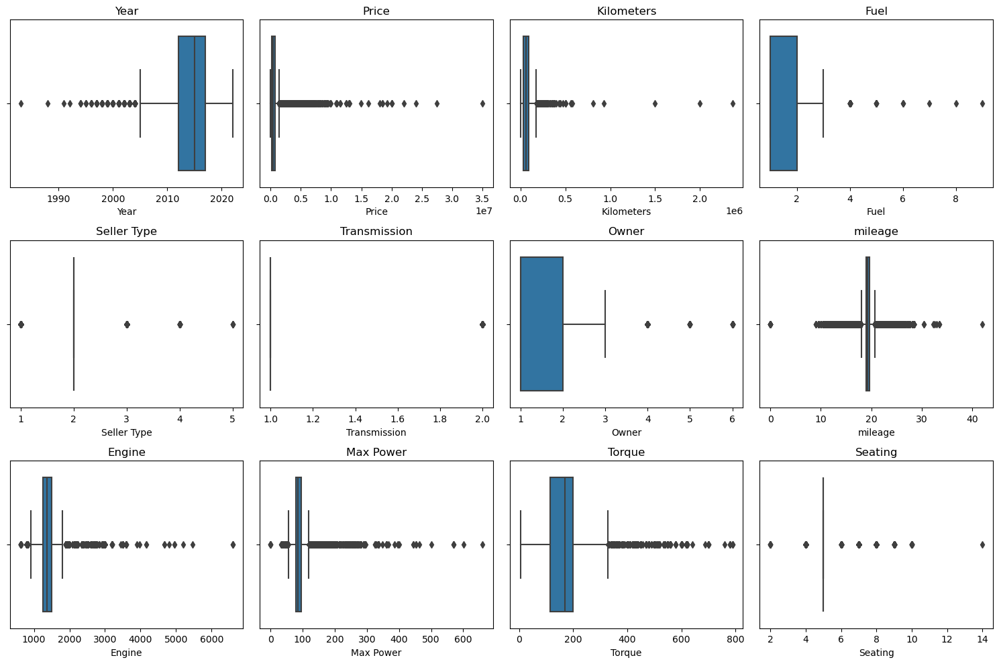

In [52]:
# Definir el tamaño de la figura
plt.figure(figsize=(15, 10))

# Iterar sobre todas las columnas de newdata_clean
for i, column in enumerate(newdata_clean.columns):
    # Crear un subplot para cada columna
    plt.subplot(3, 4, i+1)
    
    # Crear el boxplot para la columna actual
    sns.boxplot(x=newdata_clean[column])
    
    # Agregar título a cada subplot
    plt.title(column)

# Ajustar el espacio entre los subplots
plt.tight_layout()

# Mostrar los gráficos
plt.show()

In [53]:
# Duplicar el DataFrame newdata_clean
newdata_clean2 = newdata_clean.copy()

In [54]:
# Establecer límites para cada columna
limits = {
    'Kilometers': (0, 200000),
    'Engine': (800, 4000),
    'Year': (1990, 2024),
    'Owner': (1, 4),
    'mileage': (10, 30),
    'Max Power': (0, 300),
    'Torque': (0, 500),
    'Seating': (2, 8),
}
# Eliminar valores atípicos basados en los límites establecidos
for column, (lower_limit, upper_limit) in limits.items():
    newdata_clean2 = newdata_clean2[(newdata_clean2[column] >= lower_limit) & (newdata_clean2[column] <= upper_limit)]

# Mostrar el resumen del nuevo DataFrame
print(newdata_clean2.describe())

               Year         Price     Kilometers          Fuel   Seller Type  \
count  13730.000000  1.373000e+04   13730.000000  13730.000000  13730.000000   
mean    2014.088128  7.050731e+05   63306.983103      1.565186      1.869629   
std        3.978119  9.071306e+05   39471.404689      0.555215      0.433050   
min     1991.000000  1.000000e+04       1.000000      1.000000      1.000000   
25%     2012.000000  2.700000e+05   32000.000000      1.000000      2.000000   
50%     2015.000000  4.700000e+05   60000.000000      2.000000      2.000000   
75%     2017.000000  7.300000e+05   90000.000000      2.000000      2.000000   
max     2022.000000  1.250000e+07  200000.000000      8.000000      5.000000   

       Transmission         Owner       mileage        Engine     Max Power  \
count  13730.000000  13730.000000  13730.000000  13730.000000  13730.000000   
mean       1.165331      1.404297     19.408155   1455.489731     94.683534   
std        0.371493      0.673134      2.7

In [59]:
# Filtrar valores atípicos según los límites establecidos
newdata_clean2 = newdata_clean2[(newdata_clean2['Kilometers'].between(0, 200000)) & 
                                (newdata_clean2['Engine'].between(800, 4000)) &
                                (newdata_clean2['Year'].between(1990, 2024)) &
                                (newdata_clean2['Owner'].between(1, 4)) &
                                (newdata_clean2['mileage'].between(10, 30)) &
                                (newdata_clean2['Max Power'].between(0, 300)) &
                                (newdata_clean2['Torque'].between(0, 500)) &
                                (newdata_clean2['Seating'].between(2, 8))]

# Dividir los datos en características (X) y etiquetas (y)
X_new = newdata_clean2[['Kilometers', 'Engine', 'Year', 'Transmission', 'Max Power', 'Torque']]  # Características
y_new = newdata_clean2['Price']  # Etiqueta: Precio del automóvil

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_new, X_test_new, y_train_new, y_test_new = train_test_split(X_new, y_new, test_size=0.2, random_state=42)

# Inicializar el modelo de regresión lineal
model_new = LinearRegression()

# Entrenar el modelo con los datos de entrenamiento
model_new.fit(X_train_new, y_train_new)

# Predicciones en conjunto de prueba
y_pred_new = model_new.predict(X_test_new)

# Evaluar el modelo
mse_new = mean_squared_error(y_test_new, y_pred_new)
r2_new = r2_score(y_test_new, y_pred_new)

# Imprimir los resultados
print("Mean Squared Error (New):", mse_new)
print("R^2 Score (New):", r2_new)

Mean Squared Error (New): 280075092898.0352
R^2 Score (New): 0.6687114378539059


# Resumen del Proceso de Mejora del Modelo de Regresión Lineal

Se realizaron las siguientes acciones para mejorar el modelo de regresión lineal:

1. **Identificación de Valores Atípicos y Límites:**
   Se utilizaron gráficas de caja (boxplot) para identificar valores atípicos en el conjunto de datos original newdata_clean. Basándose en estas observaciones, se establecieron límites para algunas características clave:
   - Kilometers: (0, 200000)
   - Engine: (800, 4000)
   - Year: (1990, 2024)
   - Owner: (1, 4)
   - Mileage: (10, 30)
   - Max Power: (0, 300)
   - Torque: (0, 500)
   - Seating: (2, 8)

2. **Creación de un Nuevo Conjunto de Datos con Límites:**
   Se creó un nuevo conjunto de datos llamado newdata_clean2, que es una copia del conjunto de datos original newdata_clean, pero con los límites establecidos para los valores atípicos.

3. **Reentrenamiento del Modelo de Regresión Lineal:**
   Se volvió a entrenar el modelo de regresión lineal utilizando el nuevo conjunto de datos newdata_clean2, que tenía los valores atípicos eliminados mediante la aplicación de límites.

4. **Evaluación del Modelo Mejorado:**
   Se ejecutó el modelo de regresión lineal nuevamente en el conjunto de datos mejorado newdata_clean2 y se evaluó su rendimiento. Se observó una mejora en el rendimiento del modelo en comparación con el modelo anterior.

Las métricas de evaluación del modelo mejorado fueron las siguientes:
- Mean Squared Error (Nuevo): 280075092898.0352
- R^2 Score (Nuevo): 0.6687114378539059


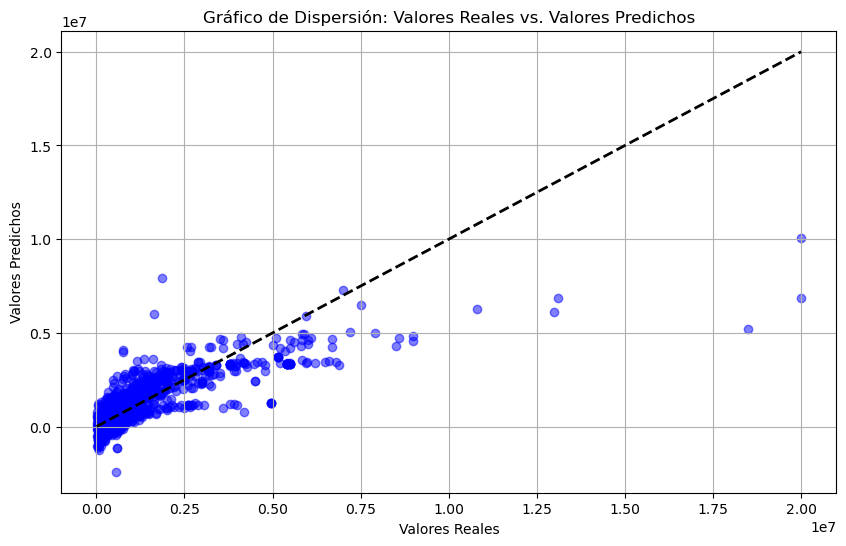

In [60]:
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Valores Reales')
plt.ylabel('Valores Predichos')
plt.title('Gráfico de Dispersión: Valores Reales vs. Valores Predichos')
plt.grid(True)
plt.show()


## Análisis del Gráfico de Dispersión: Valores Reales vs. Valores Predichos

### Dispersión de puntos:
La mayoría de los puntos azules, que representan las observaciones individuales, se concentran cerca de la línea discontinua. Esto sugiere que el modelo está logrando predicciones relativamente precisas para la mayoría de los casos.

### Línea de tendencia:
La línea discontinua representa la línea de tendencia o ajuste lineal. Esta línea de tendencia ascendente indica que, en general, a medida que aumentan los valores reales, también lo hacen los valores predichos por el modelo.

### Dispersión en los extremos:
Podemos notar una mayor dispersión de los puntos en los extremos inferiores y superiores del rango de valores reales. Esto sugiere que el modelo puede tener dificultades para realizar predicciones precisas en los valores extremos, ya sea muy altos o muy bajos.

### Valores atípicos:
Hay algunos puntos azules que se alejan significativamente de la línea de tendencia, lo que indica la presencia de valores atípicos o predicciones poco precisas para esas observaciones en particular.


C:\Users\jasim\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


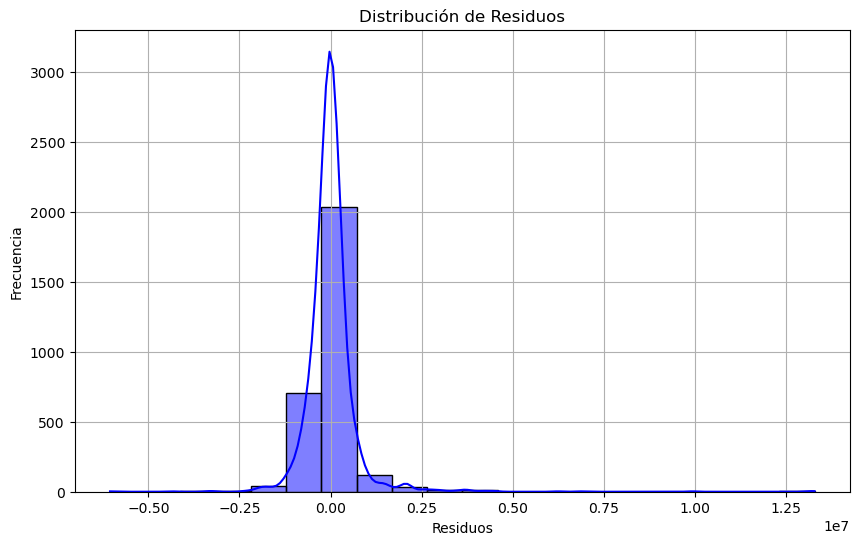

In [61]:
residuals = y_test - y_pred
plt.figure(figsize=(10, 6))
sns.histplot(residuals, kde=True, color='blue', bins=20)
plt.xlabel('Residuos')
plt.ylabel('Frecuencia')
plt.title('Distribución de Residuos')
plt.grid(True)
plt.show()


 ## Análisis del Histograma de Residuos

### Forma de la distribución:
La distribución tiene una forma aproximadamente simétrica y campanulada, con la mayor concentración de residuos cerca de cero. Esto sugiere que el modelo está prediciendo valores cercanos a los valores reales para la mayoría de las observaciones.

### Picos centrales:
Hay dos picos prominentes en el centro del histograma, indicando que hay una alta frecuencia de residuos cercanos a cero. Esto es deseable, ya que significa que el modelo está realizando predicciones precisas para una gran cantidad de observaciones.

### Dispersión:
Aunque la mayoría de los residuos se concentran cerca de cero, hay una cierta dispersión a ambos lados del centro. Esto es normal y esperado, ya que los modelos predictivos rara vez son perfectos y siempre habrá algunas diferencias entre los valores predichos y los reales.
